# Wasserstein Texture Synthesis

This is a simple continuation of a previous notebook that demonstrated [Style Transfer with a Wasserstein Metric](https://github.com/kheyer/ML-DL-Projects/tree/master/Wasserstein%20Style%20Transfer). The details of the metric can be found in the notebook, but here is a quick overview:

We can compare the similarity between images using features extracted by a pretrained neural network, as described in [Perceptual Losses for Real-Time Style Transfer and Super-Resolution](https://arxiv.org/abs/1603.08155). We can use these extracted features as a way to transform an input image into a desired output, as given by minimizing the difference between their perceptual features.

For tasks like style transfer or texture synthesis, we want a location invariant way of comparing the perceptual features. This way we optimize for features like color, texture, etc. without creating a carbon copy of the style image. Typically this is done using a Gram matrix metric, as described in [Gatys et. al](https://arxiv.org/abs/1508.06576).

However there is a flaw to the Gram matrix approach, described by [Vince Maron](https://github.com/VinceMarron/style_transfer). The Gram matrix as a metric does not have a central second moment. This means that images/matrices with different central moments (means and covariances) can have identical Gram matrices while looking extremely different.

A solution is to use an L2-Wasserstein metric with a defined central moment. We simplify the computation of this metric by assuming the perceptual features are drawn from multivariate Gaussian distributions.

In this notebook we use the L2-Wasserstein metric to synthesize texture. This means we generate a random image of noise and use gradient descent to optimize the values of the image to minimize the L2-Wasserstein distance to a given style image or images.

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import fastai
from fastai import *
from fastai.vision import *
from fastai.callbacks import *
from scipy import ndimage
from torchvision.models import vgg16_bn

In [3]:
style_path = Path('data/Styles/')

In [4]:
os.listdir(style_path)

['breaking_wave.jpg',
 'fire.jpg',
 'monet.jpg',
 'outputs',
 'palm.jpg',
 'sat1.jpg',
 'sat2.jpg',
 'sat3.jpg',
 'sat4.jpg',
 'stones.jpg',
 'wave.jpg']

# Perceptual Extraction

Perceptual features extracted with a pretrained VGG16 network

In [5]:
vgg_m = vgg16_bn(True).features.cuda().eval()
requires_grad(vgg_m, False)

In [6]:
x = torch.rand([32, 256, 1024], device=0, requires_grad=True)

In [8]:
(x@x.transpose(1,2)).shape

torch.Size([32, 256, 256])

# Wasserstein Loss

In [9]:
def calc_2_moments(tensor):
    chans = tensor.shape[1]
    tensor = tensor.view(1, chans, -1)
    n = tensor.shape[2]
    
    mu = tensor.mean(2)
    tensor = (tensor - mu[:,:,None]).squeeze(0)
    cov = torch.mm(tensor, tensor.t()) / float(n)
    
    return mu, cov

In [10]:
def get_style_vals(tensor):
    mean, cov = calc_2_moments(tensor)
    
    eigvals, eigvects = torch.symeig(cov, eigenvectors=True)
    
    eigroot_mat = torch.diag(torch.sqrt(eigvals.clamp(min=0)))
    
    root_cov = torch.mm(torch.mm(eigvects, eigroot_mat), eigvects.t())
    
    tr_cov = eigvals.clamp(min=0).sum()
    
    return mean, tr_cov, root_cov

In [11]:
def calc_l2wass_dist(mean_stl, tr_cov_stl, root_cov_stl, mean_synth, cov_synth):
    
    tr_cov_synth = torch.symeig(cov_synth, eigenvectors=True)[0].clamp(min=0).sum()
    
    mean_diff_squared = (mean_stl - mean_synth).pow(2).sum()
    
    cov_prod = torch.mm(torch.mm(root_cov_stl, cov_synth), root_cov_stl)
    
    var_overlap = torch.sqrt(torch.symeig(cov_prod, eigenvectors=True)[0].clamp(min=0)+1e-8).sum()
    
    dist = mean_diff_squared + tr_cov_stl + tr_cov_synth - 2*var_overlap
    
    return dist

In [12]:
def single_wass_loss(pred, targ):
    mean_test, tr_cov_test, root_cov_test = targ
    mean_synth, cov_synth = calc_2_moments(pred)
    loss = calc_l2wass_dist(mean_test, tr_cov_test, root_cov_test, mean_synth, cov_synth)
    return loss

# Generate Random Image and Optimize

In [13]:
def get_template(size, norm=True):
    opt_img = np.random.uniform(0, 1, size=size).astype(np.float32)
    opt_img = scipy.ndimage.filters.median_filter(opt_img, [8,8,1])
    opt_tensor = np2model_tensor(opt_img)
    
    if norm:
        opt_norm = normalize(opt_tensor, *list(map(tensor, imagenet_stats)))[None].cuda()
    else:
        opt_norm = opt_tensor[None].cuda()
        
    opt_norm.requires_grad_(True);
    
    return opt_norm

In [14]:
def get_style(fn, norm=True, scale=None):
    style_img = open_image(style_path/fn)
    
    if scale:
        a,b,c = style_img.shape
        style_img = style_img.resize((a, b//scale, c//scale))
        
    style_tensor = style_img.data
    
    if norm:
        style_norm = normalize(style_tensor, *list(map(tensor, imagenet_stats)))[None].cuda()
    else:
        style_norm = style_tensor[None].cuda()
        
    return style_norm

In [15]:
class FeatureLoss_Wass(nn.Module):
    def __init__(self, m_feat, layer_ids, wass_wgts, style_imgs, img_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wass_wgts = wass_wgts
        self.img_wgts = img_wgts
        
        self.styles = []
        
        for im in style_imgs:
            out_feat = self.make_features(im, clone=True)
            self.styles.append([get_style_vals(i) for i in out_feat])
    

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input):
        in_feat = self.make_features(input)

        self.img_losses = []
        
        for i, styles in enumerate(self.styles):
            feat_losses = [single_wass_loss(f_pred, f_targ)*w
                            for f_pred, f_targ, w in zip(in_feat, styles, self.wass_wgts)]
            self.img_losses.append(self.img_wgts[i]*sum(feat_losses))
        
        return sum(self.img_losses)
    
    def __del__(self): self.hooks.remove()

In [16]:
def generate_texture(styles, weights, blocks, block_weights, iterations=250, size=(3,400,400)):
    opt_norm = get_template(size, norm=True)
    feat_loss = FeatureLoss_Wass(vgg_m, blocks, block_weights, styles, weights)
    opt = optim.LBFGS([opt_norm])
    
    n_iter = [0]
    while n_iter[0] <= iterations:
        
        def closure():
            opt.zero_grad()
            loss = feat_loss(opt_norm)
            loss.backward()
            
            n_iter[0] += 1
            if n_iter[0]%125 == 0:
                print(f'Iteration: {n_iter[0]}, loss: {loss.item()}')
                
            return loss
        
        opt.step(closure)
        
    im = Image(denormalize(opt_norm[0].detach(), *list(map(tensor, imagenet_stats))).clamp(0,1))
    
    return im

# Ex1: Palm Trees

This method converges to a single style image fairly quickly. The VGG layers used correspond to the first 7 conv layers in the model. For more detail on why conv layers are used (as opposed to ReLU or Batchnorm) and why early layers work best, see the style transfer notebook linked in the description

In [17]:
style1 = get_style('palm.jpg', norm=True, scale=1)

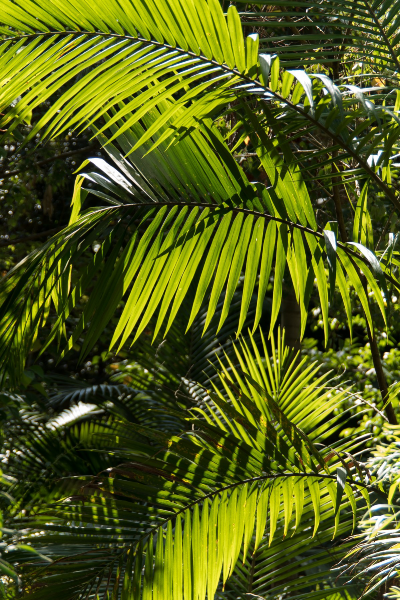

In [18]:
open_image(style_path/'palm.jpg').resize((3,600,400))

In [19]:
block_ends = [0, 3, 7, 10, 14, 17, 20]
# I designed the loss function to be able to take different weights for different model layers
# This can be fun to play around with, but for now we will weight them all evenly
block_weights = [1]*len(block_ends)

In [21]:
im1 = generate_texture([style1], [1], block_ends, block_weights, iterations=250)

Iteration: 125, loss: 1.2235355377197266
Iteration: 250, loss: 0.3305511474609375


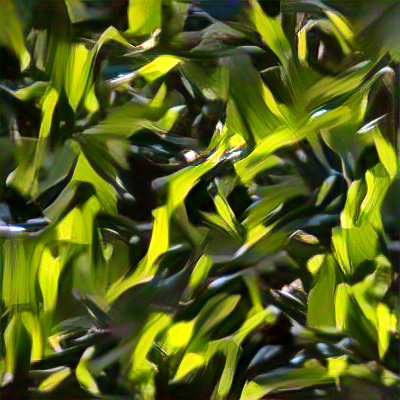

In [22]:
im1

# Style Image Scale Matters

The above was generated with the style image at natural resolution. Observe what happens when the style image is scaled down 2x, 3x, 4x. My guess is that the size of a given texture feature with respect to the receptive field of activations in the model impacts results.

Iteration: 125, loss: 0.526153564453125
Iteration: 250, loss: 0.05913543701171875


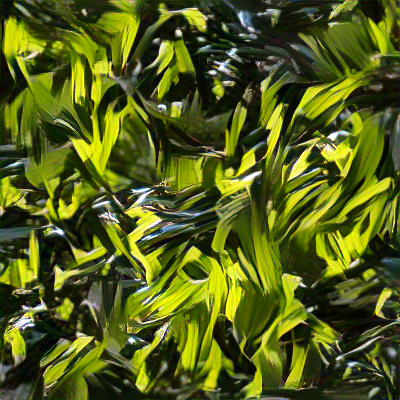

In [23]:
style1 = get_style('palm.jpg', norm=True, scale=2)
im2 = generate_texture([style1], [1], block_ends, block_weights, iterations=250)
im2

Iteration: 125, loss: 0.21544647216796875
Iteration: 250, loss: -0.00438690185546875


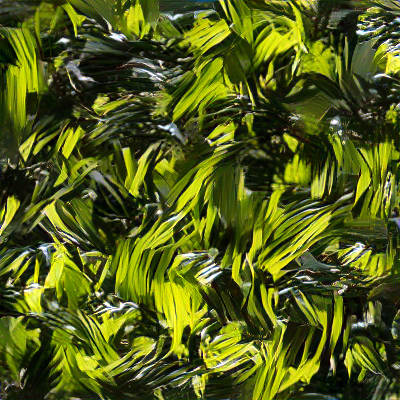

In [24]:
style1 = get_style('palm.jpg', norm=True, scale=3)
im3 = generate_texture([style1], [1], block_ends, block_weights, iterations=250)
im3

Iteration: 125, loss: 0.11138534545898438
Iteration: 250, loss: 0.0153045654296875


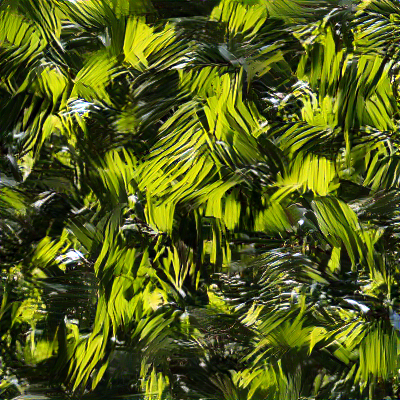

In [25]:
style1 = get_style('palm.jpg', norm=True, scale=4)
im4 = generate_texture([style1], [1], block_ends, block_weights, iterations=250)
im4

# Textures with Defined Edges do Well

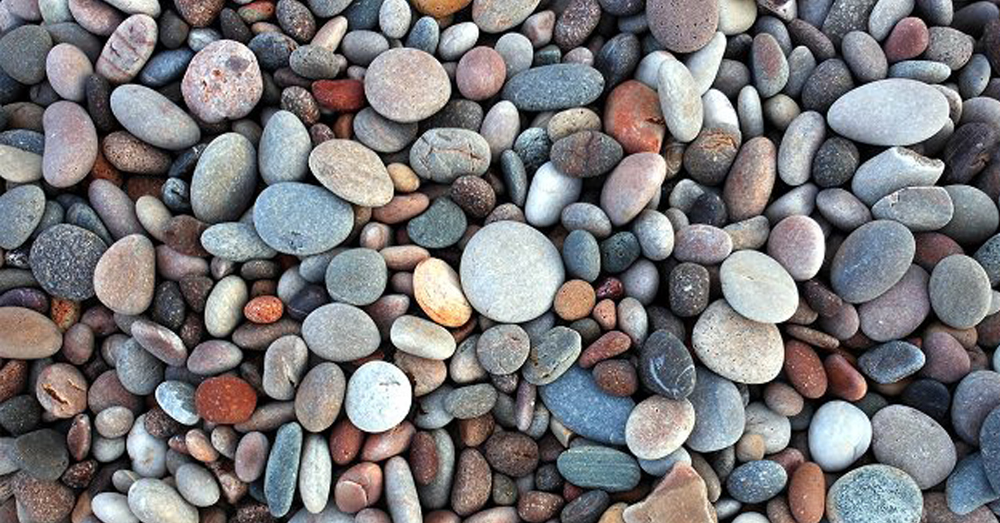

In [21]:
style2 = get_style('stones.jpg', norm=True, scale=3)
open_image(style_path/'stones.jpg')

Iteration: 125, loss: 0.06656646728515625
Iteration: 250, loss: -0.020748138427734375


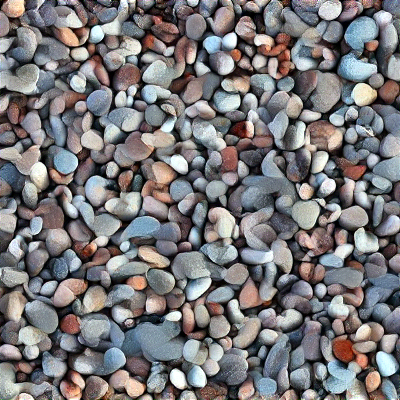

In [27]:
im5 = generate_texture([style2], [1], block_ends, block_weights, iterations=250)
im5

# More Fluid Textures Perform Worse

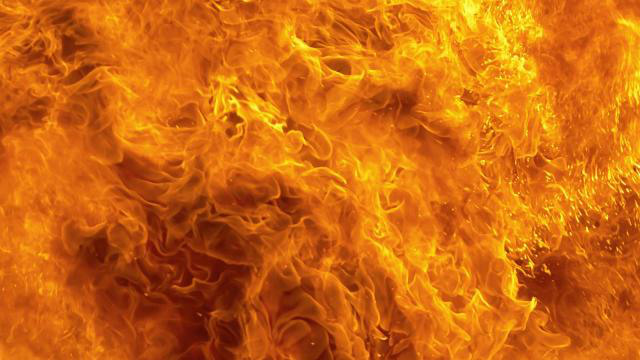

In [22]:
style3 = get_style('fire.jpg', norm=True, scale=1)
open_image(style_path/'fire.jpg')

Iteration: 125, loss: 0.28009605407714844
Iteration: 250, loss: 0.029239654541015625


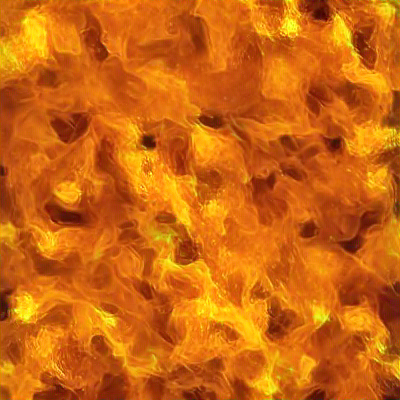

In [29]:
im6 = generate_texture([style3], [1], block_ends, block_weights, iterations=250)
im6

# We can Optimize to Weighted Combinations of Multiple Style Images

Iteration: 125, loss: 21.348026275634766
Iteration: 250, loss: 21.217660903930664


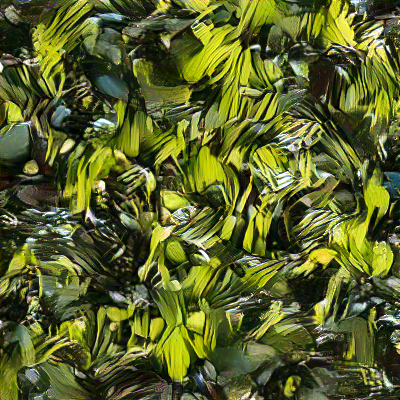

In [24]:
im7 = generate_texture([style1, style2], [0.8, 0.2], block_ends, block_weights, iterations=250)
im7

Iteration: 125, loss: 21.339387893676758
Iteration: 250, loss: 21.20926856994629


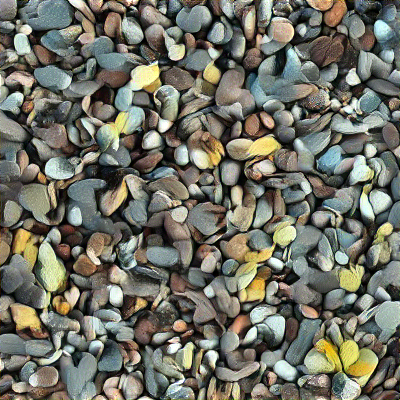

In [25]:
im8 = generate_texture([style1, style2], [0.2, 0.8], block_ends, block_weights, iterations=250)
im8

Iteration: 125, loss: 135.42880249023438
Iteration: 250, loss: 134.96499633789062


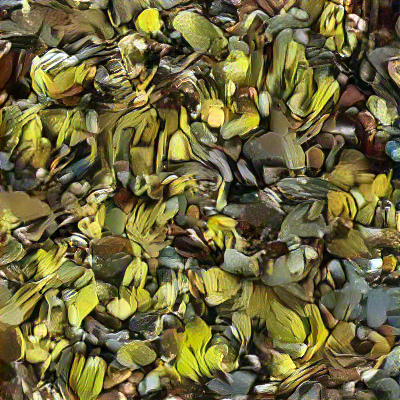

In [26]:
im9 = generate_texture([style1, style2, style3], [1.2, 1, 0.3], block_ends, block_weights, iterations=250)
im9

# We can make some fun 4 way composites

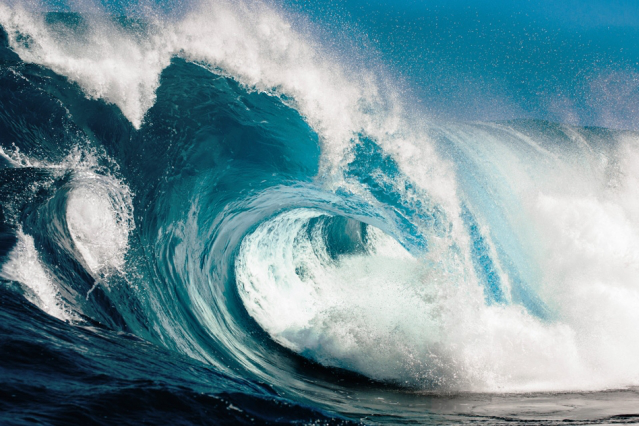

In [27]:
style4 = get_style('breaking_wave.jpg', norm=True, scale=2)
open_image(style_path/'breaking_wave.jpg')

In [17]:
weights = [[1,0,0,0], [.75,0,0,.25], [.5,0,0,.5], [.25,0,0,.75], [0,0,0,1],
[.75,.25,0,0], [.5625,.1875,.0625,.1875], [.375,.125,.125,.375], [.1875,.0625,.1875,.5625], [0,0,.25,.75],
[.5,.5,0,0], [.375,.375,.125,.125], [.25,.25,.25,.25], [.125,.125,.375,.375], [0,0,.5,.5],
[.25,.75,0,0], [.1875,.5625,.1875,.0625], [.125,.375,.375,.125], [.0625,.1875,.5625,.1875], [0,0,.75,.25],
[0,1,0,0], [0,.75,.25,0], [0,.5,.5,0], [0,.25,.75,0], [0,0,1,0]]

In [29]:
styles = [style1, style2, style3, style4]

In [18]:
ims = [generate_texture(styles, w, block_ends, block_weights, iterations=250) for w in weights]

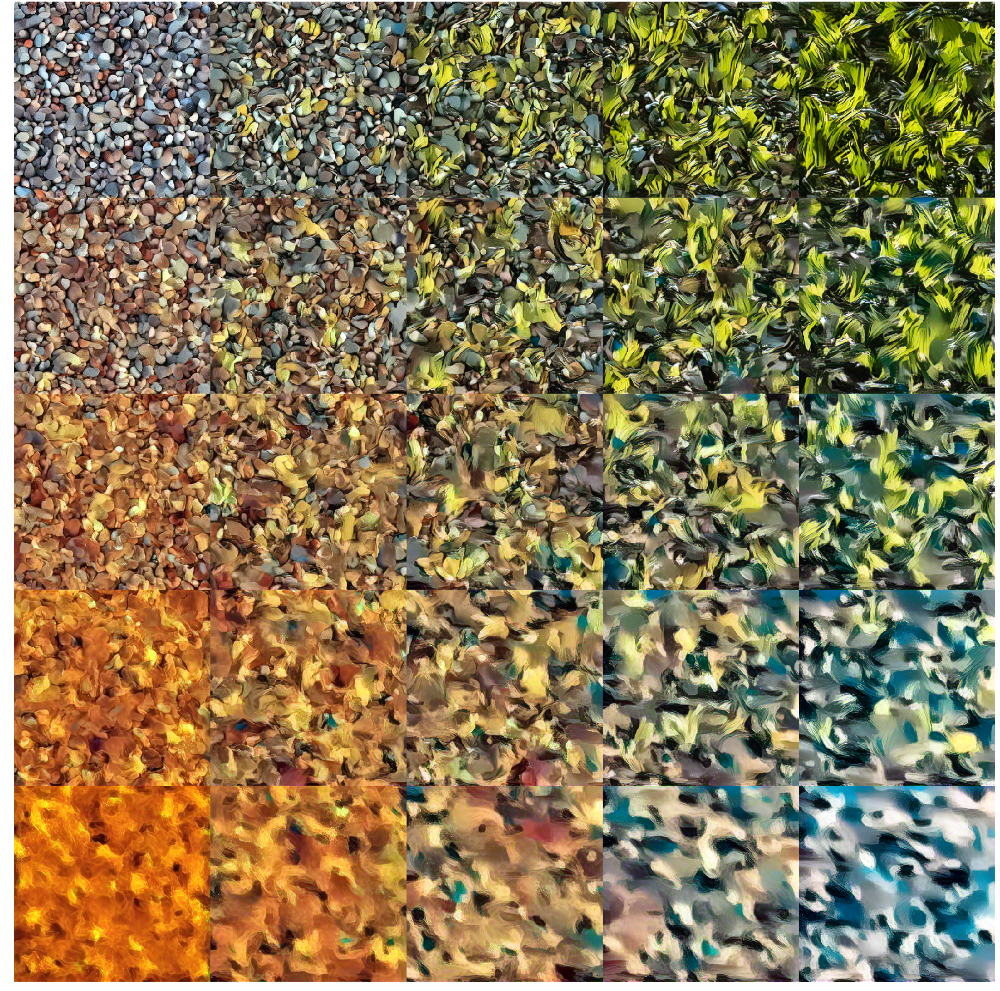

In [19]:
fig, axes = plt.subplots(5,5, figsize=(25,25))
fig.subplots_adjust(hspace=0.0, wspace=0, left=0, right=1, top=1, bottom=0)

for i, (im, ax) in enumerate(zip(ims, axes.flat)):
    show_image(im.data.clamp(0,1), ax=ax)
    Image(im.data.clamp(0,1)).save(style_path/f'outputs/imsat_{i}.png')

plt.savefig(style_path/'outputs/sat_grid.png', bbox_inches = 'tight', pad_inches = 0)

In [20]:
style5 = get_style('sat1.jpg', norm=True, scale=1)
style6 = get_style('sat2.jpg', norm=True, scale=2)
style7 = get_style('sat3.jpg', norm=True, scale=3)
style8 = get_style('sat4.jpg', norm=True, scale=2)

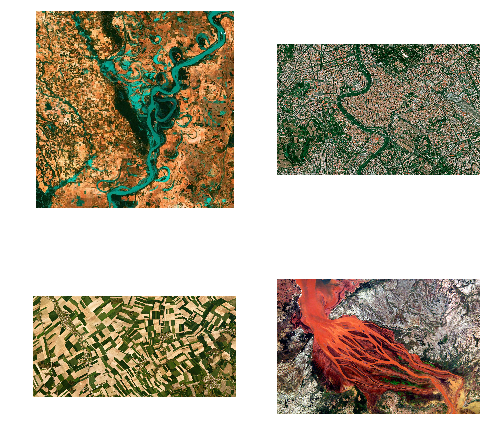

In [21]:
fig, axes = plt.subplots(2,2, figsize=(8,8))
fns = ['sat1.jpg', 'sat2.jpg', 'sat3.jpg', 'sat4.jpg']

for i, ax in enumerate(axes.flat):
    im_sat = open_image(style_path/fns[i])
    show_image(im_sat, ax=ax)

In [22]:
ims = [generate_texture(styles, w, block_ends, block_weights, iterations=250) for w in weights]

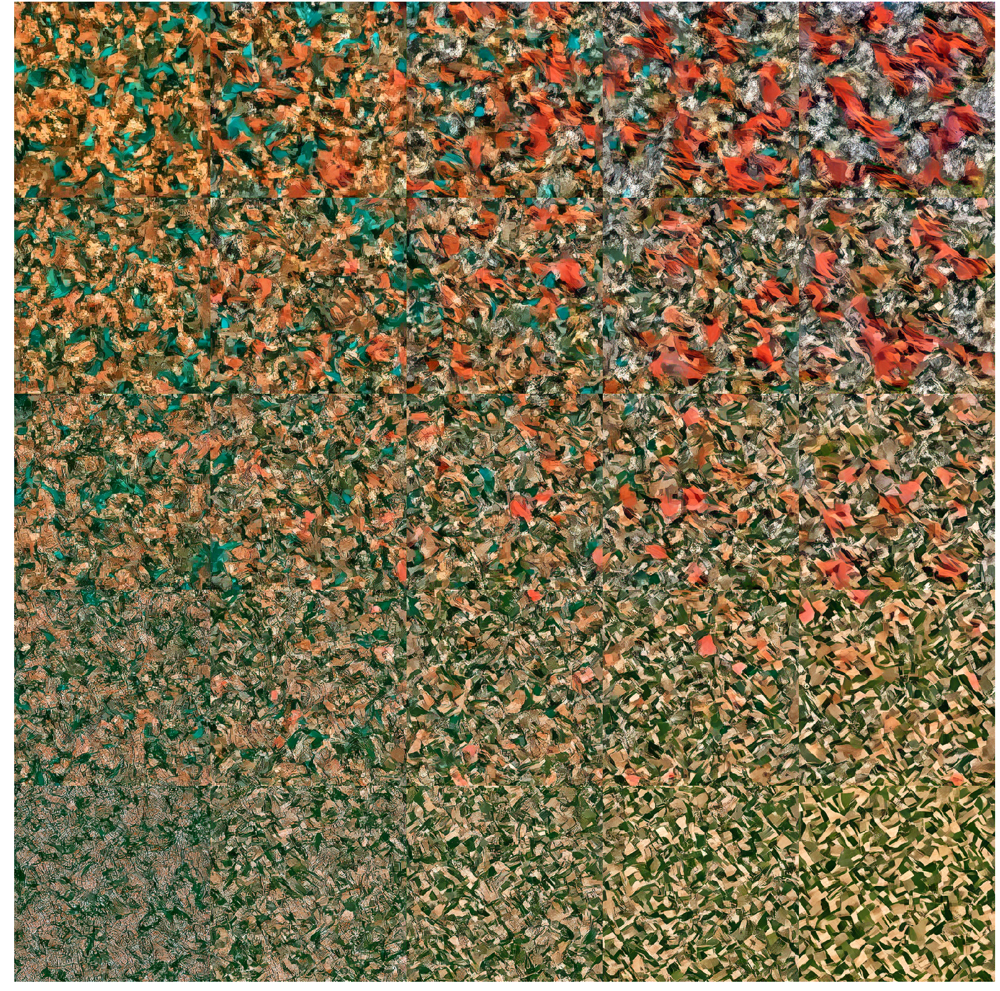

In [23]:
fig, axes = plt.subplots(5,5, figsize=(25,25))
fig.subplots_adjust(hspace=0.0, wspace=0, left=0, right=1, top=1, bottom=0)

for i, (im, ax) in enumerate(zip(ims, axes.flat)):
    show_image(im.data.clamp(0,1), ax=ax)
    Image(im.data.clamp(0,1)).save(style_path/f'outputs/imsat_{i}.png')

plt.savefig(style_path/'outputs/sat_grid.png', bbox_inches = 'tight', pad_inches = 0)